# **Application of trained model to detect sticks in all images**

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
%cd /content/gdrive/My Drive/MRCNN/

/content/gdrive/My Drive/MRCNN


In [4]:
import os
import sys
import random
import math
import re
import time
import numpy as np
import tensorflow as tf
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Root directory of the project
ROOT_DIR = os.getcwd()

# Import Mask RCNN
sys.path.append(ROOT_DIR + "/mrcnn")  # To find local version of the library
from mrcnn import utils
from mrcnn import visualize
from mrcnn.visualize import display_images
import mrcnn.model as modellib
from mrcnn.model import log
sys.path.append(ROOT_DIR + "/urinestick") 
import urinestick as stick

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

config = stick.StickConfig()
STICK_DIR = os.path.join(ROOT_DIR, "dataset")
print(STICK_DIR)

/content/gdrive/My Drive/MRCNN/dataset


In [5]:
# Override the training configurations with a few
# changes for inferencing.
class InferenceConfig(config.__class__):
    # Run detection on one image at a time
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

config = InferenceConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.95
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  512
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE        

In [7]:
# Device to load the neural network on.
# Useful if you're training a model on the same 
# machine, in which case use CPU and leave the
# GPU for training.
DEVICE = "/cpu:0"  # /cpu:0 or /gpu:0

# Inspect the model in training or inference modes
# values: 'inference' or 'training'
# TODO: code for 'training' test mode not ready yet
TEST_MODE = "inference"

In [ ]:
# Load dataset

dataset = stick.StickDataset()
dataset.load_stick(STICK_DIR, "all")

In [8]:
# Create model in inference mode
with tf.device(DEVICE):
    model = modellib.MaskRCNN(mode="inference", model_dir=MODEL_DIR,
                              config=config)

Instructions for updating:
Use fn_output_signature instead


In [9]:
# Set path to weights file
weights_path = MODEL_DIR + "/Fold_2/mask_rcnn_stick_0015.h5"
# weights_path = MODEL_DIR + "/Run2/mask_rcnn_stick_0015.h5"

# Or, load the last model you trained
# weights_path = model.find_last()

# Load weights
print("Loading weights ", weights_path)
model.load_weights(weights_path, by_name=True)

Loading weights  /content/gdrive/My Drive/MRCNN/logs/Fold_2/mask_rcnn_stick_0015.h5


In [10]:
def crop_rect(img, rect):
    """
    Function, that crops a rectangle from an image

    Input:
      img: Whole image
      rect: Parameters of the rectangle that will be cut out: in the form center

    Output:
      detectedStick
    """

    # Shape of the Image
    height, width = img.shape[0], img.shape[1]

    # Create border, to prevent cutting off image parts during rotation
    # T = np.float32([[1, 0, width/2], [0, 1, height/2]])
    # img_mod = cv2.warpAffine(img, T, (width*2, height*2))

    # Parameters of the rectangle
    center = rect[0]
    size = rect[1]
    angle = rect[2]

    center, size = tuple(map(int, center)), tuple(map(int, size))

    M = cv2.getRotationMatrix2D(center, angle, 1)
    img_rot = cv2.warpAffine(img, M, (width, height))
    img_crop = cv2.getRectSubPix(img_rot, size, center)

    return img_crop

In [11]:
import json
import imutils
import skimage.draw
import cv2
import numpy as np
import pickle

ALL_RESULTS_DIR = "/content/gdrive/MyDrive/MRCNN/results_run_2_all.pckl"
ALL_JSON_DIR = "/content/gdrive/MyDrive/MRCNN/dataset/00_all_annotations.json"
DIR = "/content/gdrive/MyDrive/MRCNN/dataset/"

In [ ]:
# Load ground truth annotations
annotations = json.load(open((ALL_JSON_DIR)))
print(len(annotations))

results = []
images = []
annotations_filtered =[]
f = open(ALL_RESULTS_DIR, 'ab')
for annot in annotations:

  image_dir = DIR+annot["filename"]
  print(image_dir)
  # Read image
  if not os.path.isfile(image_dir) or not annot["regions"]:
    continue
  image = skimage.io.imread(image_dir)

  # Run object detection
  result = model.detect([image], verbose=0)
  results.append(result)

  pickle.dump([result,image,annot], f)
  

f.close()

In [ ]:
import json
import imutils
import skimage.draw
import cv2
import numpy as np
import pickle

f = open(ALL_RESULTS_DIR, 'rb')
result,image,annot = pickle.load(f)
print("results successfully loaded")

print(" PPV; \tNPV; \tFilename")

i = 0;
f = open(ALL_RESULTS_DIR, 'rb')
cntPos = 0
cntNeg = 0
sumPPV = 0
sumNPV = 0

while 1:
  
  try:
    result,image,annot = pickle.load(f)
  except EOFError:
    print("DONE")
    break 

  height, width, _ = image.shape
  mask_ref = np.zeros([height, width], dtype=np.uint8)
  
  p = annot["regions"]["0"]["shape_attributes"]
  rr, cc = skimage.draw.polygon(p['all_points_y'], p['all_points_x'])
  mask_ref[rr, cc] = 1

  
  r = result[0]
  mask_sub = r['masks']
  mask_sub = mask_sub.astype(np.uint8)
  #print(mask_sub)
  if (mask_sub.size == 0):
    print("------  ;------- ;       {}".format(annot["filename"]))
    cntNeg += 1
    continue
  mask_sub = mask_sub[:,:,0]
 
  #Compare both masks
  super_mask = mask_sub + mask_ref
  neg_mask = mask_sub.astype(np.int8) - mask_ref.astype(np.int8)
  true_positive = sum(sum(map(lambda x : x == 2, super_mask)))
  true_negative = sum(sum(map(lambda x : x == 0, super_mask)))
  false_positive = sum(sum(map(lambda x : x == 1, neg_mask)))
  false_negative = sum(sum(map(lambda x : x == -1, neg_mask)))

  PPV = true_positive/(true_positive + false_positive)  #Positiver Prädiktiver Wert
  NPV = true_negative/(true_negative+false_negative)       #Negativer Prädiktiver Wert    
  
  print("{:0.2%};\t {:0.2%}; \t{}".format(PPV,NPV,annot["filename"]))
  
  sumPPV += PPV

  # Classify according to PPV and NPV
  if PPV > 0.9 and NPV > 0.9:
    cntPos += 1
    
  else:
    cntNeg += 1
  i += 1
  
print("Anzahl Positiv;Anzahl Negativ; MeanPPV poitiv; meanNPV positiv")    
print("{}  ;{};  {:0.4%}  ;{:0.4%}".format(cntPos, cntNeg, sumPPV/349 , sumNPV/cntPos))

results successfully loaded
 PPV; 	NPV; 	Filename
97.44%;	 99.86%; 	1603271951737-2020-10-2111.18.581973969612.jpg
96.69%;	 99.94%; 	1603271982959-2020-10-2111.19.28621676386.jpg
99.97%;	 99.83%; 	1603272005310-2020-10-2111.19.551891528089.jpg
99.09%;	 99.87%; 	1603272029320-2020-10-2111.20.201254878295.jpg
99.27%;	 99.80%; 	1603272091920-2020-10-2111.21.21568442473.jpg
99.65%;	 99.80%; 	1603620562730-image.jpg
96.56%;	 99.88%; 	1603620701644-image.jpg
95.84%;	 99.87%; 	1603620752927-image.jpg
92.26%;	 99.95%; 	1603620802290-image.jpg
94.62%;	 99.97%; 	1603620904589-image.jpg
93.01%;	 99.88%; 	1603737121096-2020-10-2619.31.41616716142936120433.jpg
86.37%;	 99.76%; 	1603737178024-2020-10-2619.32.422599225595687711221.jpg
91.48%;	 99.69%; 	1603737205305-2020-10-2619.33.144832115230494832774.jpg
90.66%;	 99.81%; 	1603737238134-2020-10-2619.33.474215939897443487205.jpg
80.69%;	 99.90%; 	1603737392697-2020-10-2619.36.214454838820263367241.jpg
96.92%;	 99.88%; 	1603789904613-image.jpg
98.87%

Results File:  1603271951737-2020-10-2111.18.581973969612.jpg


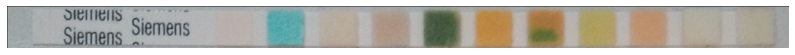

Results File:  1603271982959-2020-10-2111.19.28621676386.jpg


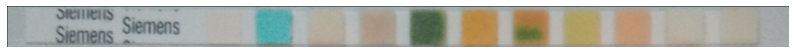

Results File:  1603272005310-2020-10-2111.19.551891528089.jpg


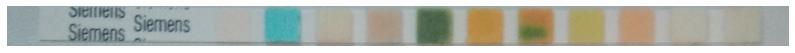

Results File:  1603272029320-2020-10-2111.20.201254878295.jpg


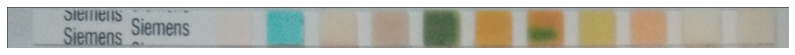

Results File:  1603272091920-2020-10-2111.21.21568442473.jpg


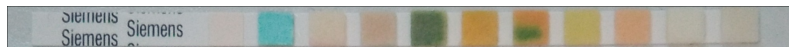

Results File:  1603620562730-image.jpg


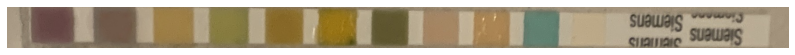

Results File:  1603620701644-image.jpg


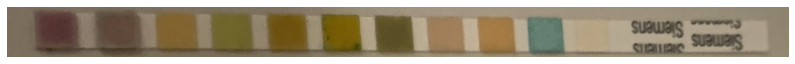

Results File:  1603620752927-image.jpg


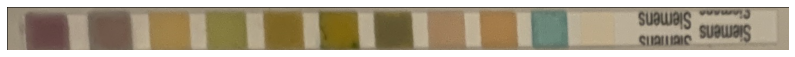

Results File:  1603620802290-image.jpg


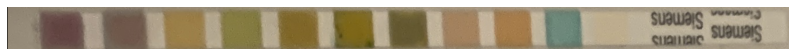

Results File:  1603620904589-image.jpg


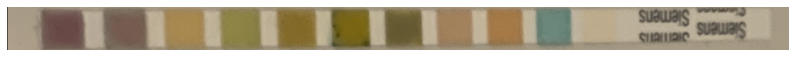

Results File:  1603737121096-2020-10-2619.31.41616716142936120433.jpg


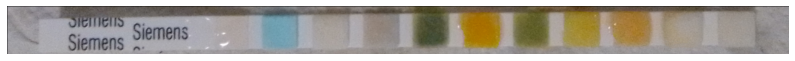

Results File:  1603737178024-2020-10-2619.32.422599225595687711221.jpg


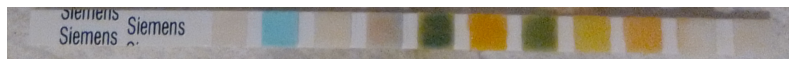

Results File:  1603737205305-2020-10-2619.33.144832115230494832774.jpg


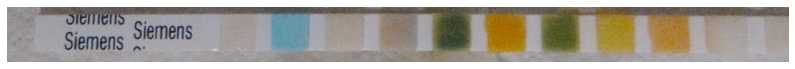

Results File:  1603737238134-2020-10-2619.33.474215939897443487205.jpg


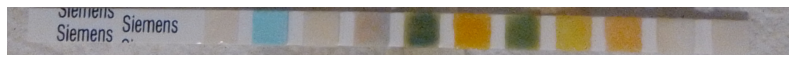

Results File:  1603737392697-2020-10-2619.36.214454838820263367241.jpg


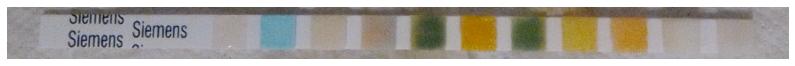

Results File:  1603789904613-image.jpg


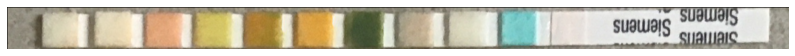

Results File:  1603789920446-image.jpg


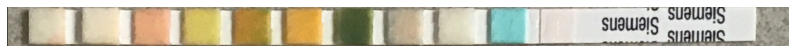

Results File:  1603789932404-image.jpg


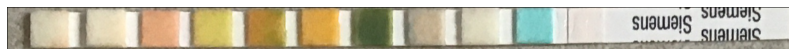

Results File:  1603789956037-image.jpg


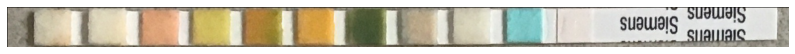

Results File:  1603789998383-image.jpg


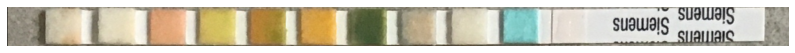

Results File:  1604347536258-2020-11-0221.04.527950054788212704818.jpg


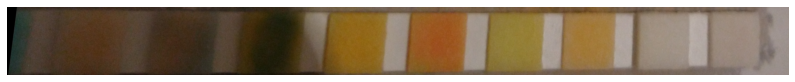

Results File:  1604347691476-2020-11-0221.07.584019032657385811007.jpg


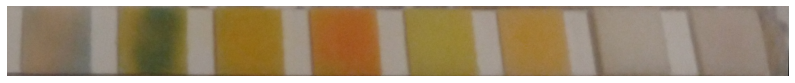

Results File:  1604347893130-2020-11-0221.11.076903911206488238889.jpg


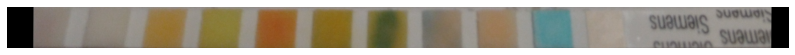

Results File:  1604348016461-2020-11-0221.13.194761313437091000228.jpg


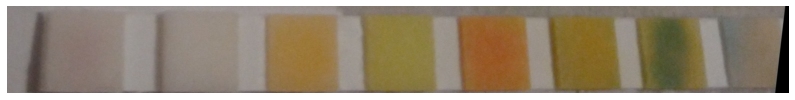

Results File:  1604422025295-16044218898194693381376830618597.jpg


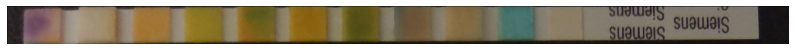

Results File:  1604422273086-16044221782034042049778582751899.jpg


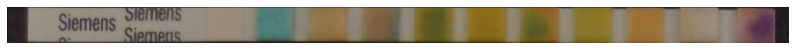

Results File:  1604422324218-16044222999028255033985398352081.jpg


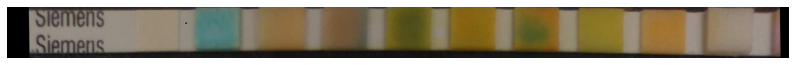

Results File:  1604422383562-16044223651283236103463337417815.jpg


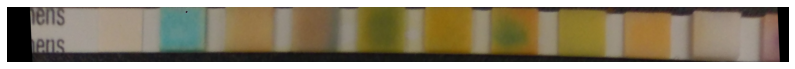

Results File:  1604422486276-16044224708968135871005050469289.jpg


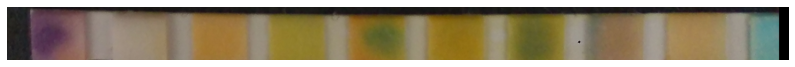

Results File:  1604572813636-IMG_0038.jpg


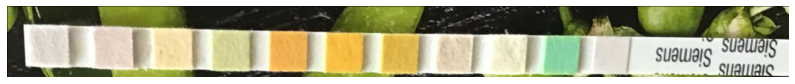

Results File:  1604650211649-image.jpg


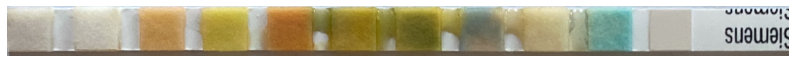

Results File:  1604650666528-image.jpg


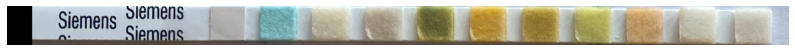

Results File:  1604650704551-image.jpg


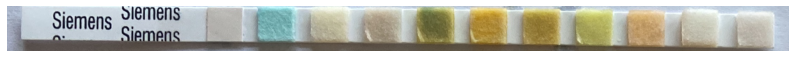

Results File:  1604650741737-image.jpg


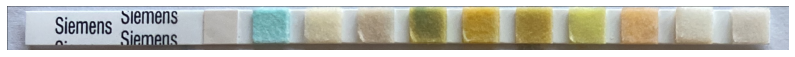

Results File:  1604650773203-image.jpg


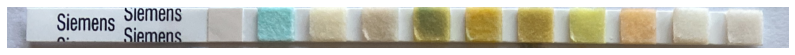

Results File:  1604650911731-image.jpg


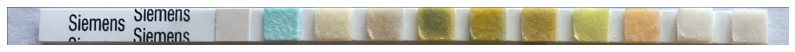

Results File:  1604657909309-16046578641335239298983456179214.jpg


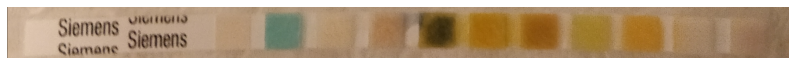

Results File:  1604658319049-1604658309622639723713555354734.jpg


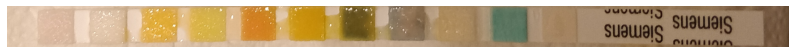

Results File:  1604658356633-1604658348849607243165462994702.jpg


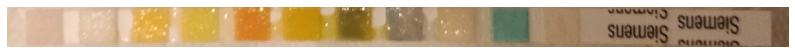

Results File:  1604658430956-16046584215753499547415921700558.jpg


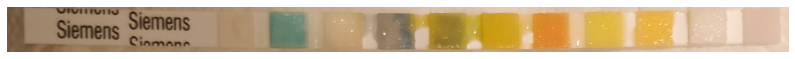

Results File:  1604658456338-16046584491356383241057991136011.jpg


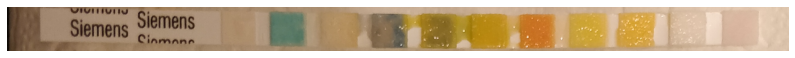

Results File:  1604658516693-16046585079741801506445184917302.jpg


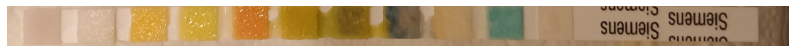

Results File:  1604694121874-16046941041408019301671308691503.jpg


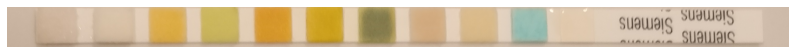

Results File:  1604694298918-16046942671368993873882940588272.jpg


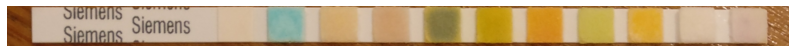

Results File:  1604694347281-1604694327666210364832011335078.jpg


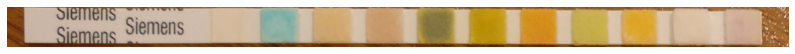

Results File:  1604694394569-16046943721107867309667216633530.jpg


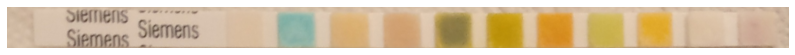

Results File:  1604694498837-16046944837353056058422953453017.jpg


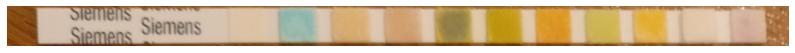

Results File:  1604750181968-16047501653581946240009.jpg


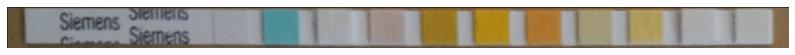

Results File:  1604750219713-1604750206934-1681850966.jpg


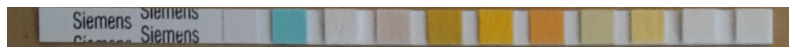

Results File:  1604750243836-1604750232607-691295904.jpg


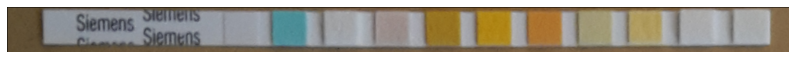

Results File:  1604750274761-16047502597211782015567.jpg


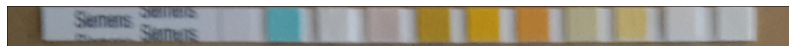

Results File:  1604750429199-16047503753211891253215.jpg


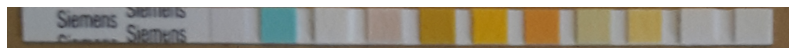

Results File:  1604819447067-1604819422680-1714572482.jpg


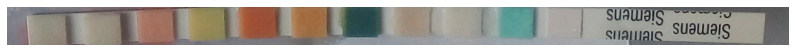

Results File:  1604819510462-1604819498113-1985039377.jpg


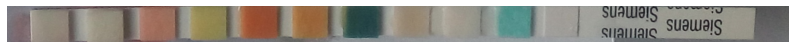

Results File:  1604819538793-16048195264901487773829.jpg


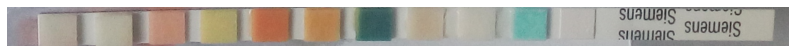

Results File:  1604819567770-1604819550693-1634652758.jpg


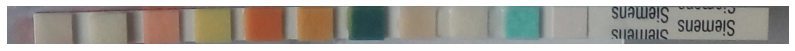

Results File:  1604819642334-1604819630338-1930570648.jpg


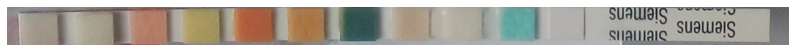

Results File:  1604820652316-1604820627334443365143.jpg


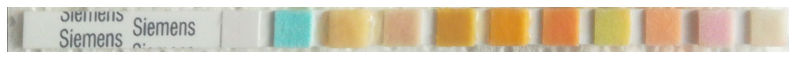

Results File:  1604820717688-16048206935451135878230.jpg


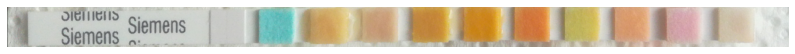

Results File:  1604820767309-1604820747558613449396.jpg


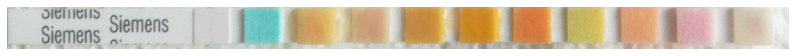

Results File:  1604820810232-1604820793389421723249.jpg


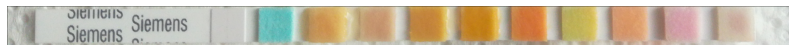

Results File:  1604821002343-16048209514351596338513.jpg


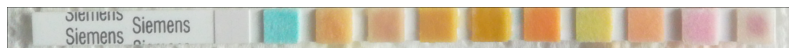

Results File:  1604827171341-1604827152877-491031706.jpg


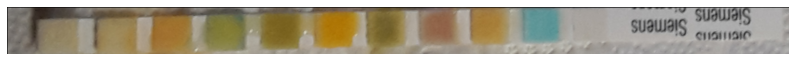

Results File:  1604827230965-1604827216916888892255.jpg


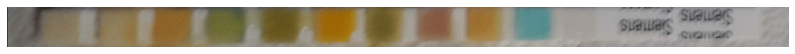

Results File:  1604827690929-1604827671004-1763937670.jpg


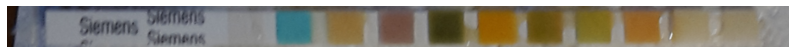

Results File:  1604827748072-16048277371861781414345.jpg


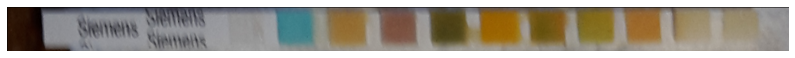

Results File:  1604827803382-16048277701971341392107.jpg


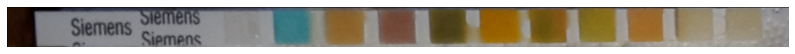

Results File:  1604827860470-1604827849796-120721911.jpg


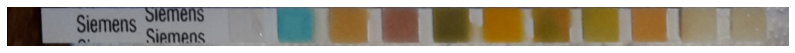

Results File:  1604827979242-1604827938830-596683312.jpg


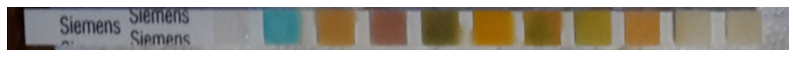

Results File:  1604996259573-16049962468266442867140257496033.jpg


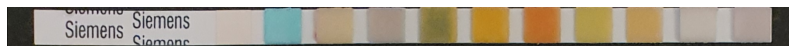

Results File:  1604996304369-16049962951007007316795373568700.jpg


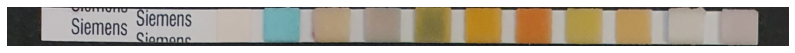

Results File:  1604996327273-1604996319872634018084314932516.jpg


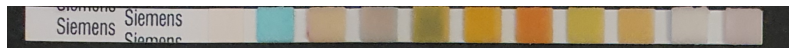

Results File:  1604996395470-16049963901264613575117018228508.jpg


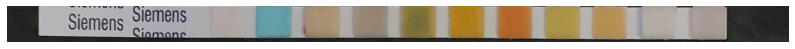

Results File:  1604996469388-16049964627008772572477010824494.jpg


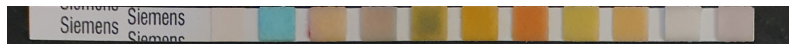

Results File:  1605347251628-image.jpg


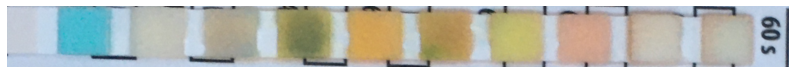

Results File:  1605347322907-image.jpg


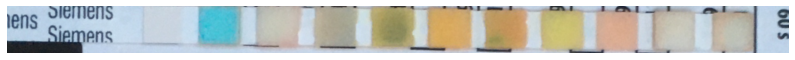

------  ;------- ;       1605347358846-image.jpg
Results File:  1605347394629-image.jpg


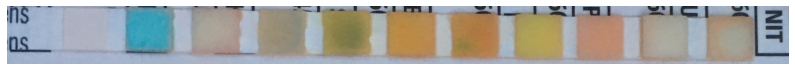

Results File:  1605347451451-image.jpg


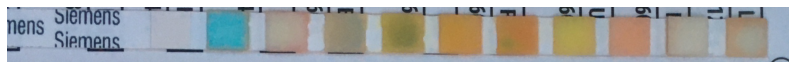

Results File:  1605347803572-image.jpg


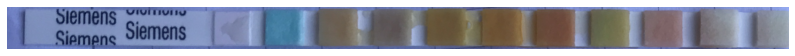

Results File:  1605347826532-image.jpg


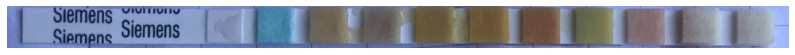

Results File:  1605347871643-image.jpg


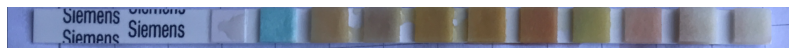

Results File:  1605347937731-image.jpg


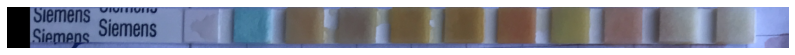

Results File:  1605356132550-2020-11-14 13.15.20.jpg


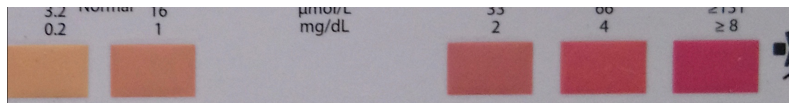

Results File:  1605356184561-2020-11-14 13.16.14.jpg


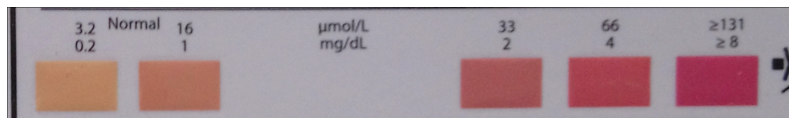

Results File:  1605356215310-2020-11-14 13.16.42.jpg


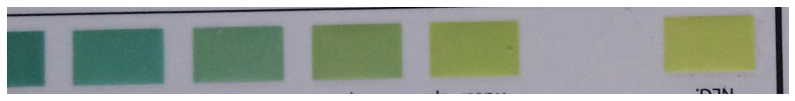

Results File:  1605356246266-2020-11-14 13.17.14.jpg


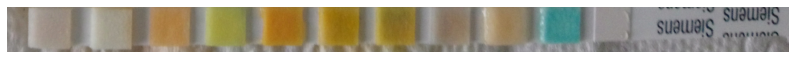

Results File:  1605356328327-2020-11-14 13.18.39.jpg


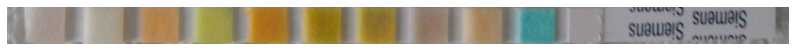

Results File:  1605362996422-2020-11-1415.09.38698670379571328370.jpg


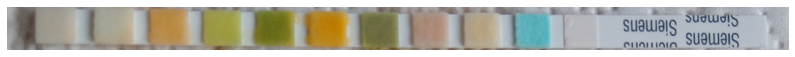

Results File:  1605363104391-2020-11-1415.11.134437023586071108463.jpg


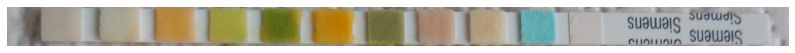

Results File:  1605363140259-2020-11-1415.12.12534272845798857760.jpg


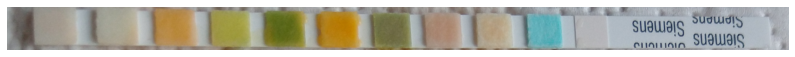

Results File:  1605363280470-2020-11-1415.14.27331819303155036427.jpg


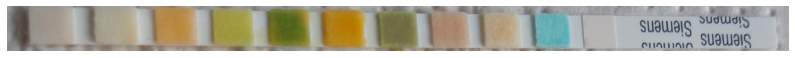

Results File:  1605363432568-2020-11-1415.17.062996779558834588406.jpg


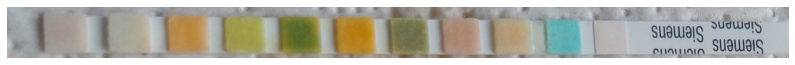

Results File:  1605367079998-image.jpg


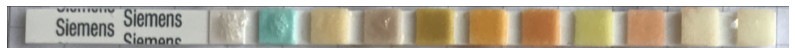

Results File:  1605367110916-image.jpg


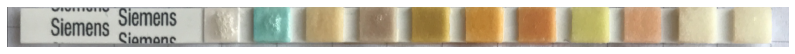

Results File:  1605367130751-image.jpg


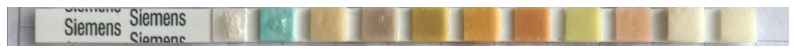

Results File:  1605367160947-image.jpg


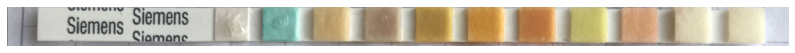

Results File:  1605367207338-image.jpg


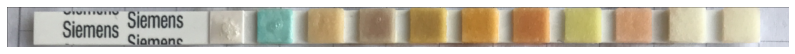

Results File:  1605368722168-image.jpg


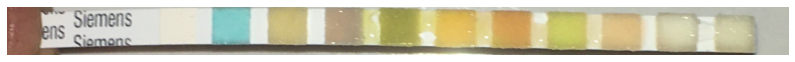

Results File:  1605368761922-image.jpg


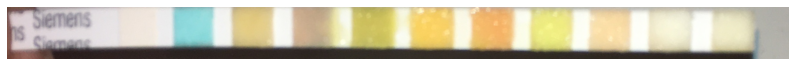

Results File:  1605368799919-image.jpg


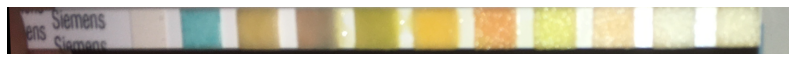

Results File:  1605368808626-16053687969671489409661.jpg


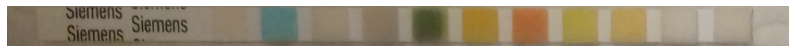

Results File:  1605368827198-image.jpg


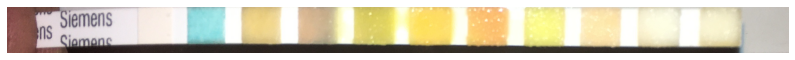

Results File:  1605368880532-image.jpg


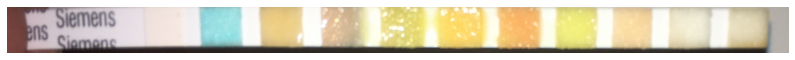

Results File:  1605368883340-16053688596131861194117.jpg


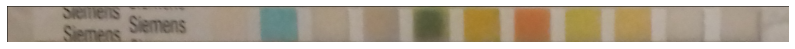

Results File:  1605368909089-1605368898417-13225481.jpg


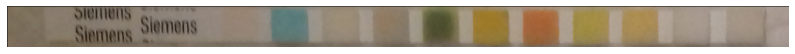

Results File:  1605368963241-1605368953900-1538427202.jpg


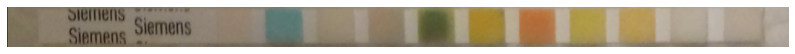

Results File:  1605369055926-1605369042130-18521828.jpg


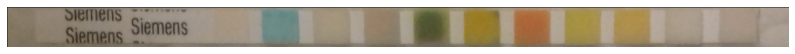

Results File:  1605542104095-16055420633237809992214136314522.jpg


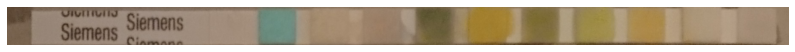

Results File:  1605542241829-1605542233881432344177920557046.jpg


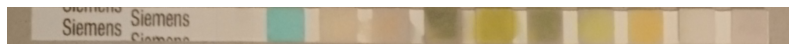

Results File:  1605542279530-16055422725438769650855814122561.jpg


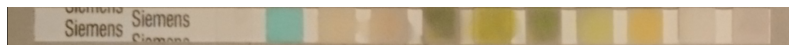

Results File:  1605542319029-16055423149412045598871719917094.jpg


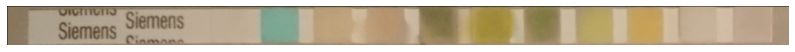

Results File:  1605542416343-16055424120858059714048107947517.jpg


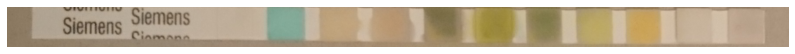

Results File:  1605867039067-image.jpg


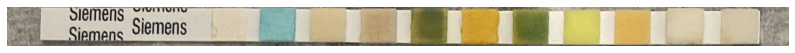

Results File:  1605867151060-image.jpg


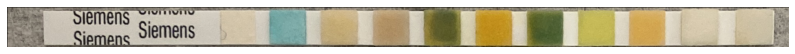

Results File:  1605867189329-image.jpg


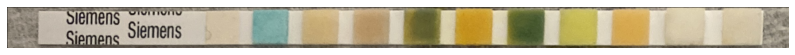

Results File:  1605867218208-image.jpg


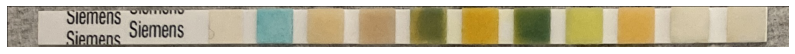

Results File:  1605867282033-image.jpg


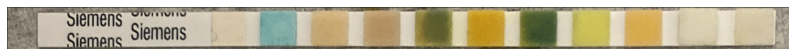

Results File:  1606079093703-16060790842141605544827782480186.jpg


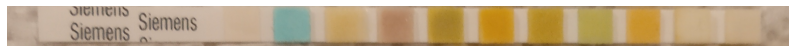

Results File:  1606079172808-16060791650323410281977237094037.jpg


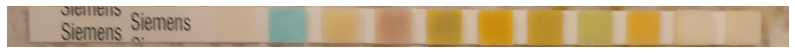

Results File:  1606079193739-16060791858395407089749915844809.jpg


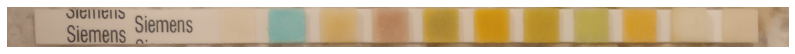

Results File:  1606079225724-16060792175021231448280778779521.jpg


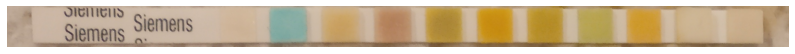

Results File:  1606079309171-16060793022836291262794346225812.jpg


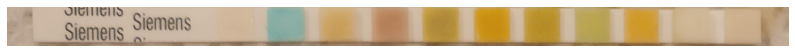

Results File:  1606080690358-image.jpg


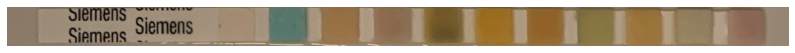

Results File:  1606080737051-image.jpg


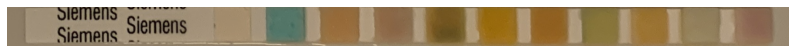

Results File:  1606080757825-image.jpg


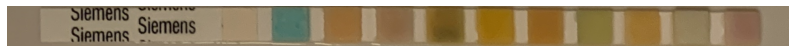

Results File:  1606080795524-image.jpg


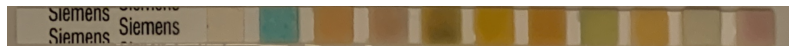

Results File:  1606080866622-image.jpg


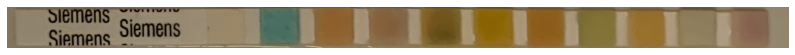

Results File:  1606134247865-1606134167164-1854658134.jpg


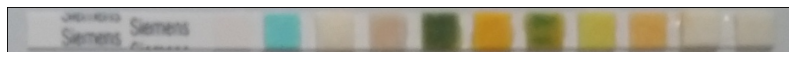

Results File:  1606134267635-1606134196016-317435825.jpg


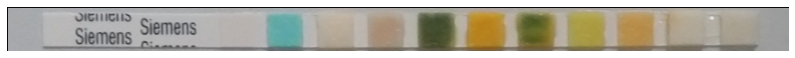

Results File:  1606134281798-16061342122871953089464.jpg


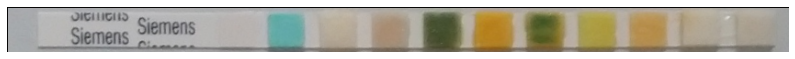

Results File:  1606134301468-1606134233410-1406717670.jpg


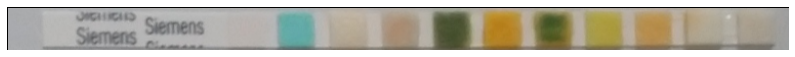

Results File:  1606134348905-1606134270679-217743549.jpg


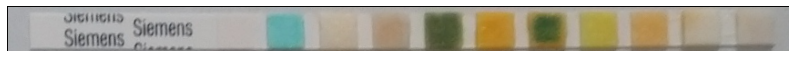

Results File:  1606315991132-1606315982300511162709259938870.jpg


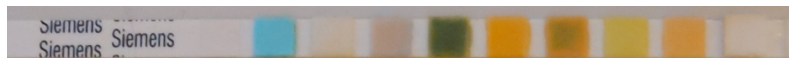

Results File:  1606316007932-16063160004419095313728790022504.jpg


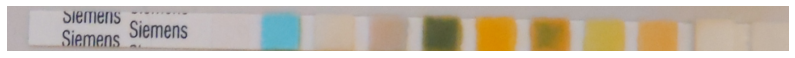

Results File:  1606316022899-1606316017307700137647214282760.jpg


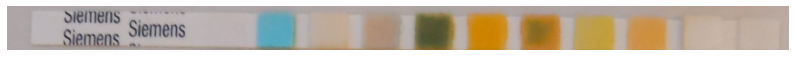

Results File:  1606316048375-1606316043384790516370060509077.jpg


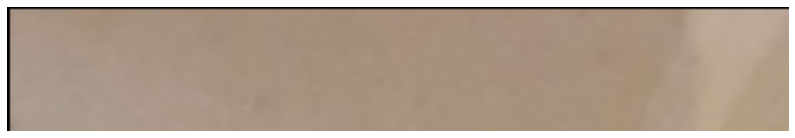

Results File:  1606316080457-1606316075490151170615163492579.jpg


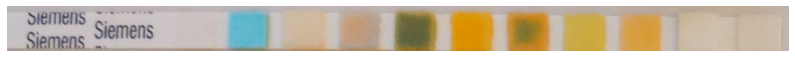

Results File:  1606753728806-16067537037374571716664756889704.jpg


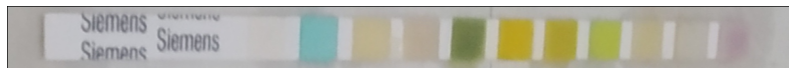

Results File:  1606753759815-1606753750212408026854152823153.jpg


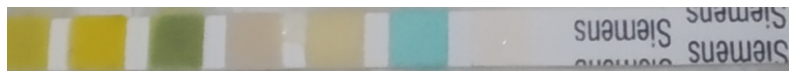

Results File:  1606753779919-16067537710325581444170158161455.jpg


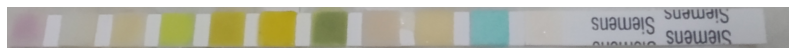

Results File:  1606753804549-16067537971012374967761648762221.jpg


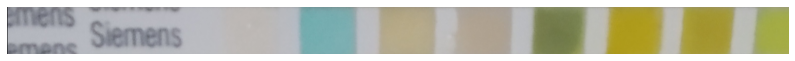

------  ;------- ;       1606753864608-16067538558916752232523575521314.jpg
Results File:  1607180635210-2020-12-0516.03.449040811210638848195.jpg


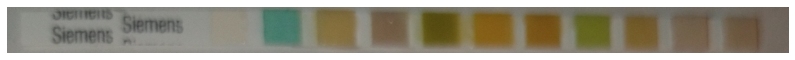

Results File:  1607180701392-2020-12-0516.04.507040523049115244398.jpg


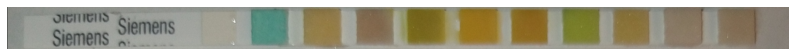

Results File:  1607180725101-2020-12-0516.05.1414479515039917482.jpg


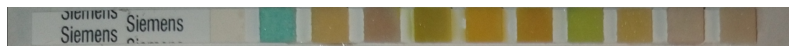

Results File:  1607180761787-2020-12-0516.05.518891076342715926013.jpg


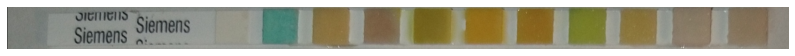

Results File:  1607180841044-2020-12-0516.07.064820053042093045855.jpg


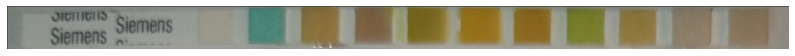

Results File:  1607678522753-16076785075288956807640065259391.jpg


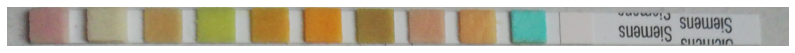

Results File:  1607678585865-16076785708855400025617131827815.jpg


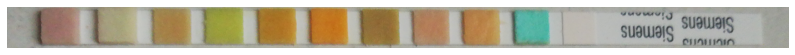

Results File:  1607678612492-16076785970666031550991614055421.jpg


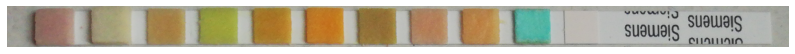

Results File:  1607678657622-16076786297598792144723168569041.jpg


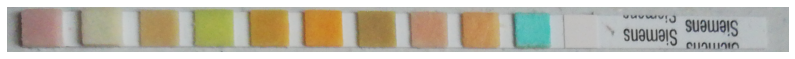

Results File:  1607678708173-16076786961002246639421511365134.jpg


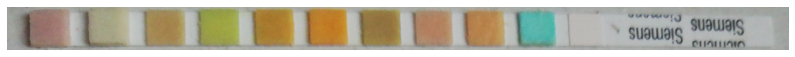

Results File:  1607684883134-image.jpg


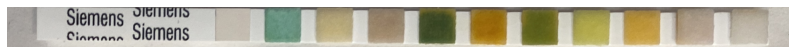

Results File:  1607684941712-image.jpg


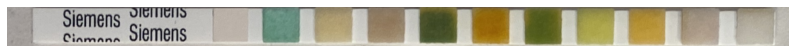

Results File:  1607684958171-image.jpg


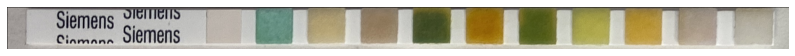

Results File:  1607684985454-image.jpg


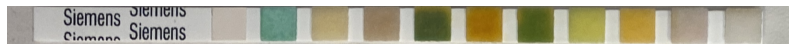

Results File:  1607685037171-image.jpg


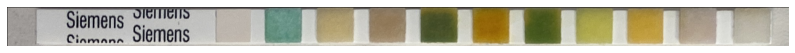

Results File:  IMG_20201102_105932_373.jpg


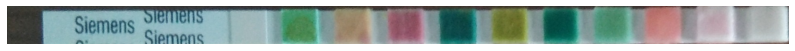

Results File:  IMG_20201102_105935_108.jpg


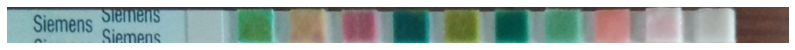

Results File:  IMG_20201102_105937_482.jpg


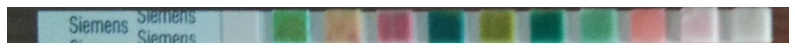

Results File:  IMG_20201102_105941_600.jpg


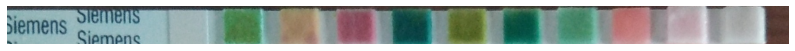

Results File:  IMG_20201102_105957_852.jpg


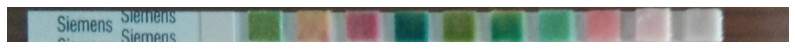

Results File:  IMG_20201102_110101_479.jpg


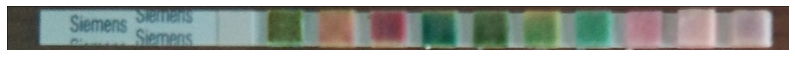

Results File:  IMG_20201102_110105_925.jpg


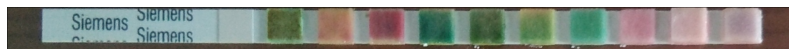

Results File:  IMG_20201102_110551_629.jpg


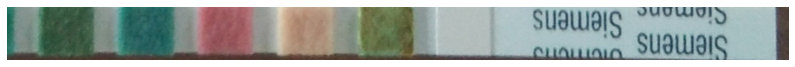

Results File:  IMG_20201102_114911_026.jpg


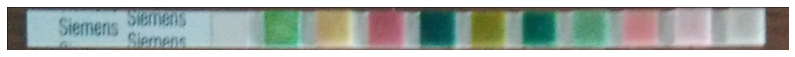

Results File:  IMG_20201102_114923_638.jpg


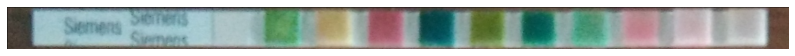

Results File:  IMG_20201102_114935_060.jpg


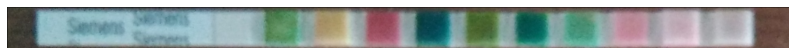

Results File:  IMG_20201102_114938_796.jpg


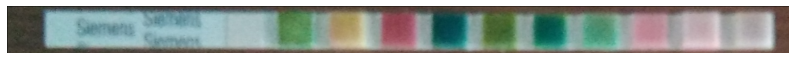

Results File:  IMG_20201102_114945_496.jpg


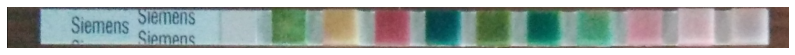

Results File:  IMG_20201102_114947_282.jpg


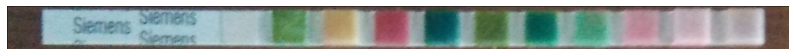

Results File:  IMG_20201102_115042_098.jpg


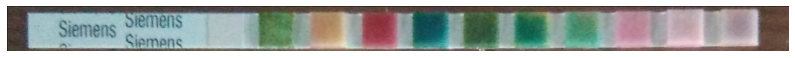

Results File:  IMG_20201214_212942_771.jpg


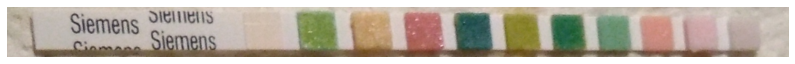

Results File:  IMG_20201214_212952_395.jpg


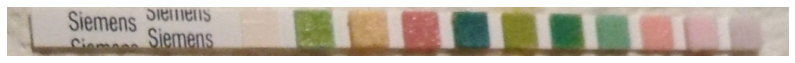

Results File:  IMG_20201214_212956_715.jpg


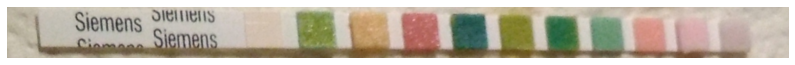

Results File:  IMG_20201214_213011_334.jpg


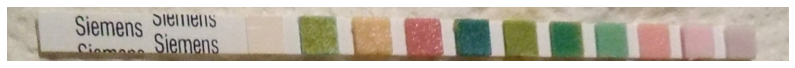

Results File:  IMG_20201214_213112_320.jpg


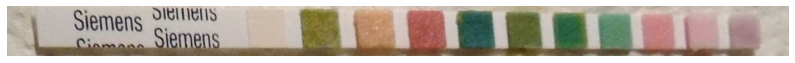

Results File:  WP_20180203_10_02_49_Pro.jpg


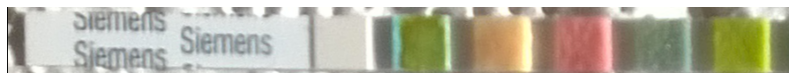

Results File:  WP_20180203_10_02_57_Pro.jpg


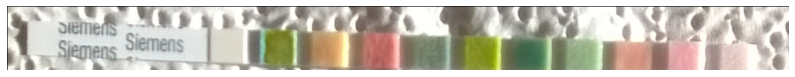

------  ;------- ;       WP_20180203_10_03_03_Pro.jpg
Results File:  WP_20180203_10_03_17_Pro.jpg


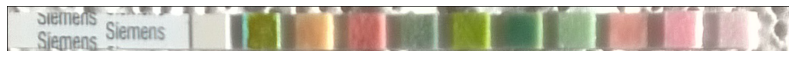

Results File:  WP_20180203_10_04_17_Pro.jpg


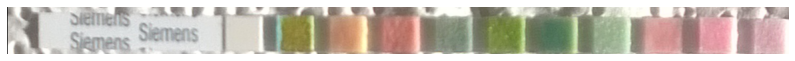

Results File:  WP_20180203_10_06_09_Pro.jpg


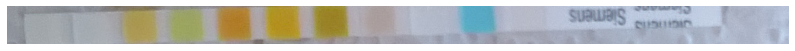

Results File:  WP_20180203_10_06_20_Pro.jpg


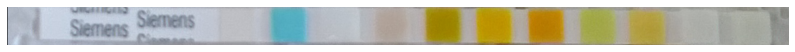

------  ;------- ;       WP_20180203_10_06_24_Pro.jpg
Results File:  WP_20180203_10_06_38_Pro.jpg


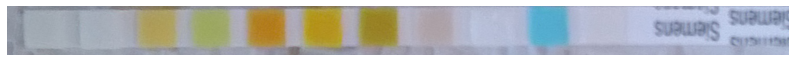

Results File:  WP_20180203_10_07_40_Pro.jpg


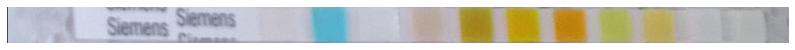

Results File:  IMG_0266.JPG


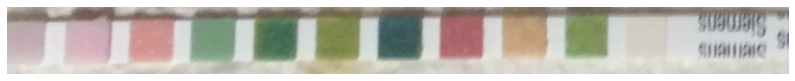

Results File:  IMG_0267.JPG


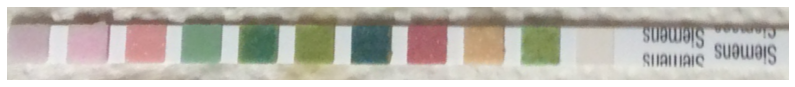

Results File:  IMG_0268.JPG


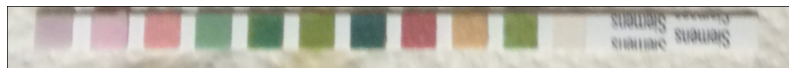

Results File:  IMG_0269.JPG


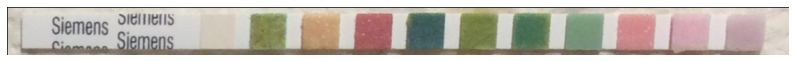

Results File:  IMG_0270.JPG


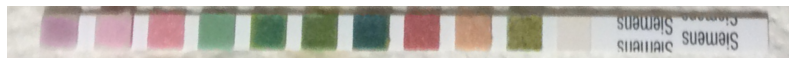

Results File:  IMG_6093.jpg


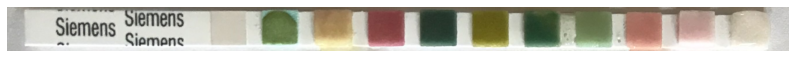

Results File:  IMG_6094.jpg


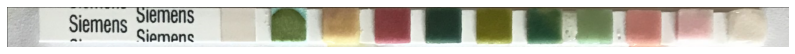

Results File:  IMG_6095.jpg


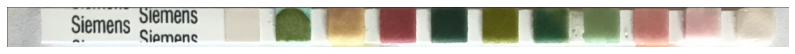

Results File:  IMG_6096.jpg


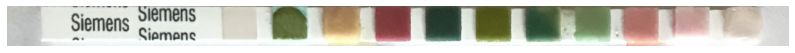

Results File:  IMG_6097.jpg


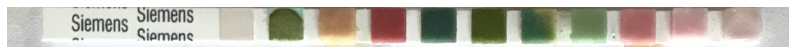

Results File:  IMG_5953.JPG


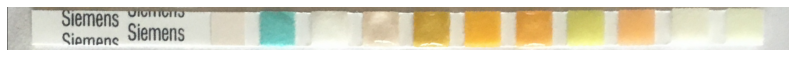

Results File:  IMG_5954.JPG


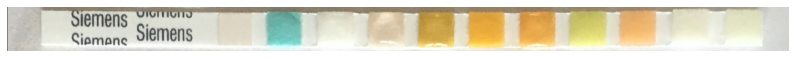

Results File:  IMG_5955.JPG


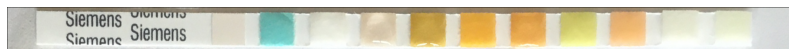

Results File:  IMG_5956.JPG


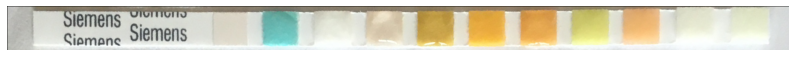

Results File:  IMG_5957.JPG


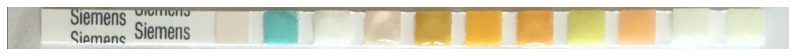

Results File:  IMG_5958.JPG


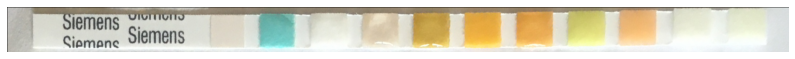

Results File:  IMG_5959.JPG


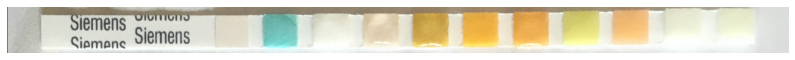

Results File:  IMG_5960.JPG


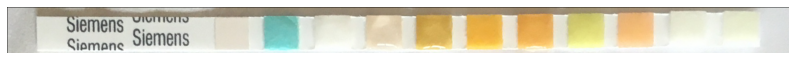

Results File:  IMG_5961.JPG


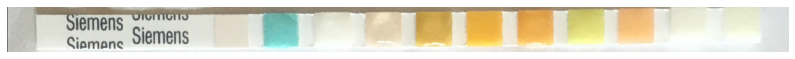

Results File:  IMG_20201125_125901_233.jpg


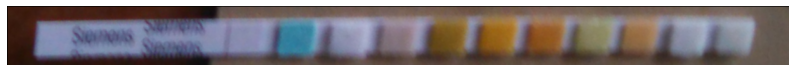

Results File:  IMG_20201125_125910_215.jpg


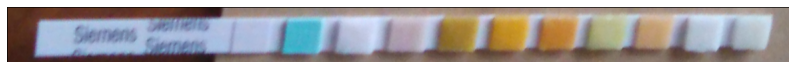

Results File:  IMG_20201125_125917_286.jpg


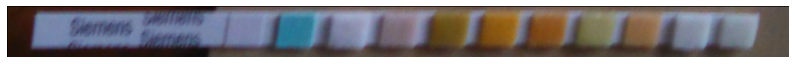

Results File:  IMG_20201125_125929_819.jpg


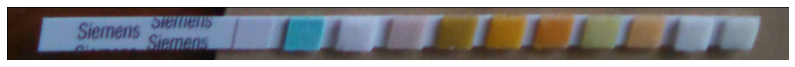

Results File:  IMG_20201125_130030_720.jpg


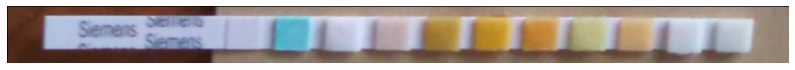

Results File:  IMG_20201125_132455_088.jpg


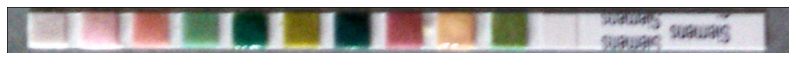

Results File:  IMG_20201125_132501_514.jpg


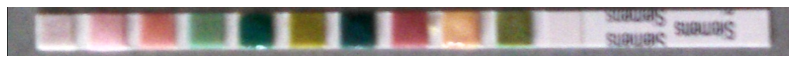

Results File:  IMG_20201125_132507_649.jpg


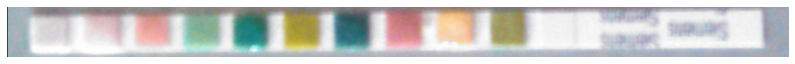

Results File:  IMG_20201125_132513_296.jpg


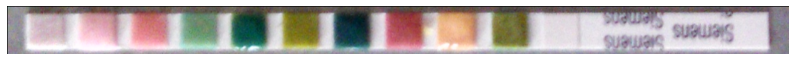

Results File:  IMG_20201125_132525_457.jpg


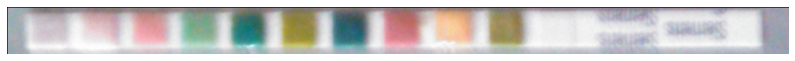

Results File:  IMG_20201125_132625_918.jpg


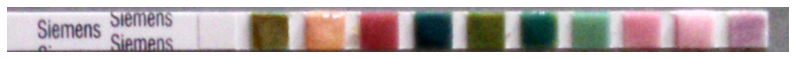

Results File:  IMG_20201125_172527_053.jpg


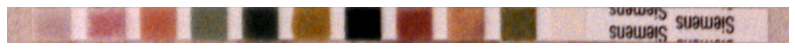

Results File:  IMG_20201125_172533_887.jpg


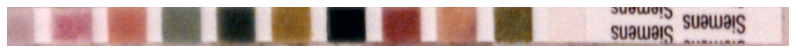

Results File:  IMG_20201125_172542_067.jpg


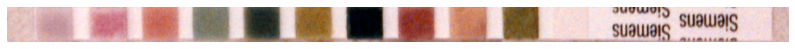

Results File:  IMG_20201125_172554_866.jpg


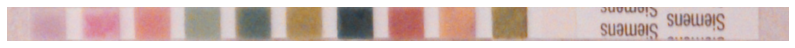

------  ;------- ;       IMG_20201125_172656_382.jpg
Results File:  IMG_20201125_172703_268.jpg


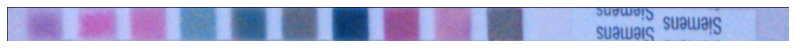

Results File:  WP_20201206_14_02_22_Pro.jpg


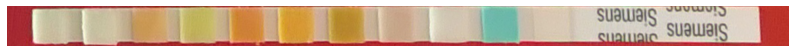

Results File:  WP_20201206_14_02_24_Pro.jpg


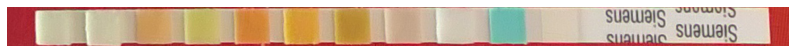

Results File:  WP_20201206_14_02_28_Pro.jpg


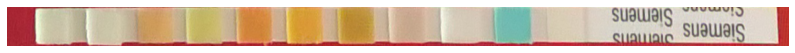

Results File:  WP_20201206_14_02_41_Pro.jpg


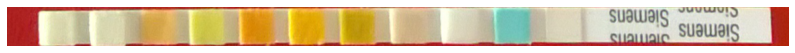

Results File:  WP_20201206_14_02_43_Pro.jpg


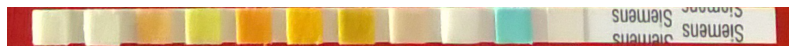

Results File:  WP_20201206_14_03_42_Pro.jpg


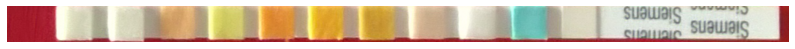

Results File:  WP_20201206_14_05_56_Pro.jpg


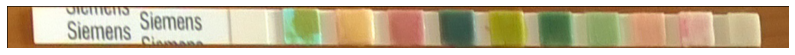

Results File:  WP_20201206_14_06_04_Pro.jpg


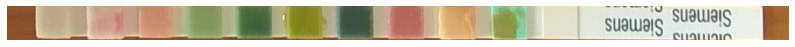

Results File:  WP_20201206_14_06_08_Pro.jpg


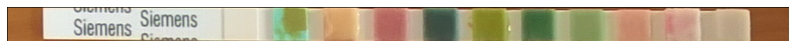

Results File:  WP_20201206_14_06_17_Pro.jpg


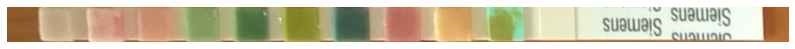

Results File:  WP_20201206_14_06_23_Pro.jpg


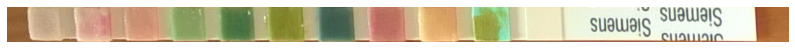

Results File:  WP_20201206_14_07_28_Pro.jpg


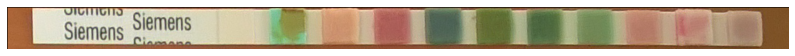

Results File:  WP_20201206_21_19_05_Pro.jpg


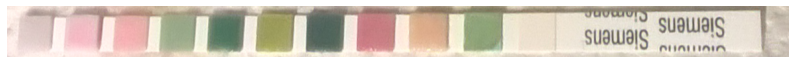

Results File:  WP_20201206_21_19_15_Pro.jpg


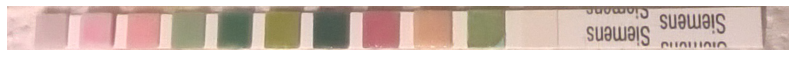

Results File:  WP_20201206_21_19_21_Pro.jpg


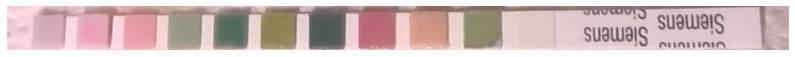

Results File:  WP_20201206_21_19_35_Pro.jpg


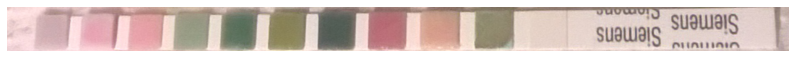

Results File:  WP_20201206_21_19_38_Pro.jpg


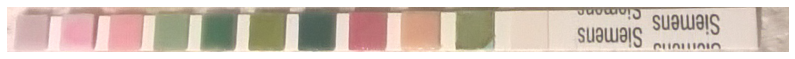

Results File:  WP_20201206_21_20_40_Pro.jpg


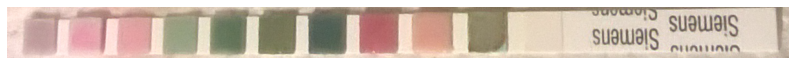

Results File:  20201115_154523.jpg


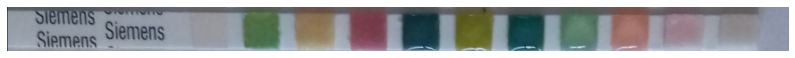

Results File:  20201115_154533.jpg


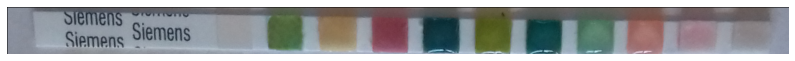

Results File:  20201115_154539.jpg


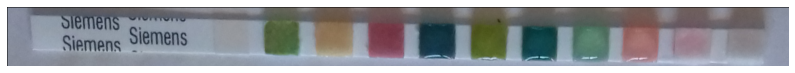

Results File:  20201115_154553.jpg


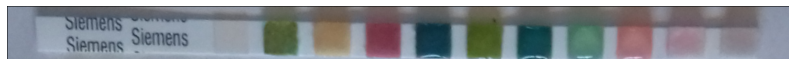

Results File:  20201115_154655.jpg


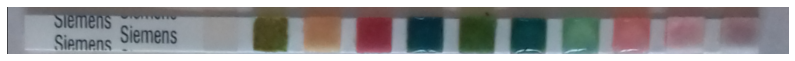

Results File:  20201125_125509.jpg


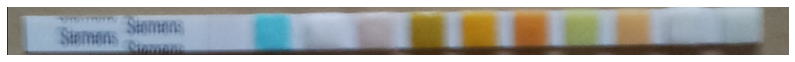

Results File:  20201125_125511.jpg


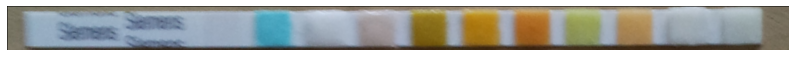

Results File:  20201125_125516.jpg


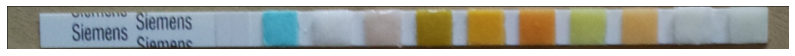

Results File:  20201125_125520.jpg


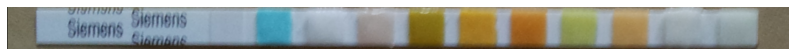

Results File:  20201125_125524.jpg


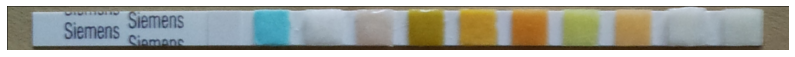

Results File:  20201125_125538.jpg


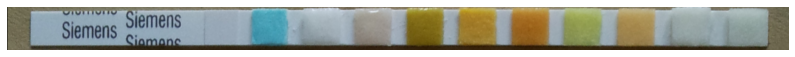

Results File:  20201125_125637.jpg


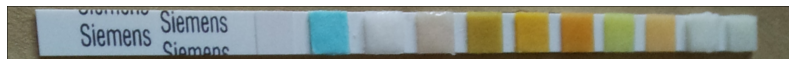

Results File:  20201125_125642.jpg


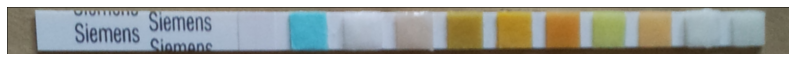

Results File:  20201125_131148.jpg


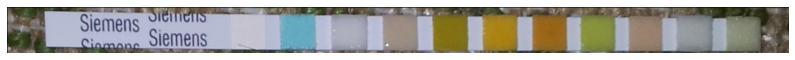

Results File:  20201125_131203.jpg


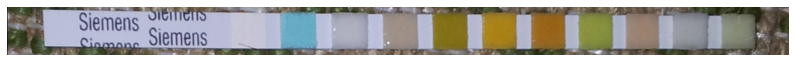

Results File:  20201125_131211.jpg


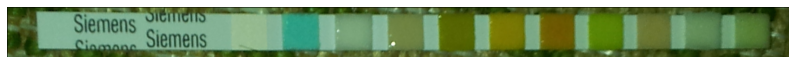

Results File:  20201125_131226.jpg


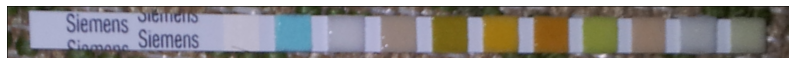

Results File:  20201125_131232.jpg


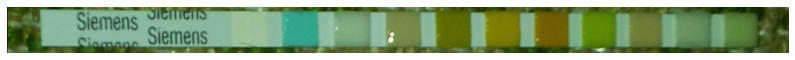

Results File:  20201125_131325.jpg


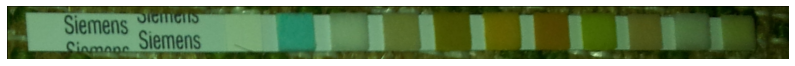

Results File:  20201125_131330.jpg


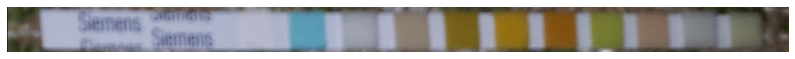

Results File:  20201125_170917.jpg


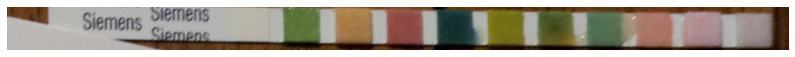

------  ;------- ;       20201125_170928.jpg
------  ;------- ;       20201125_170934.jpg
Results File:  20201125_170948.jpg


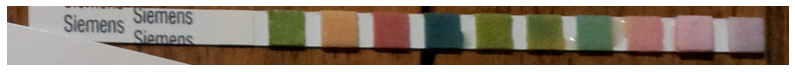

------  ;------- ;       20201125_171050.jpg
Results File:  20201125_171055.jpg


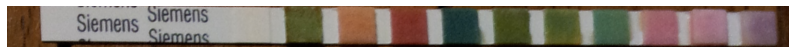

Results File:  20201125_124817.jpg


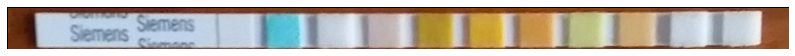

Results File:  20201125_124828.jpg


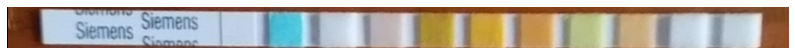

Results File:  20201125_124833.jpg


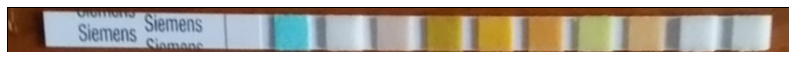

Results File:  20201125_124846.jpg


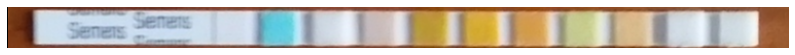

Results File:  20201125_124847.jpg


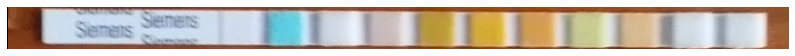

Results File:  20201125_124947.jpg


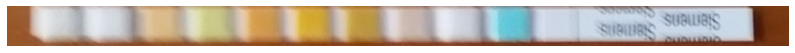

Results File:  20201125_130645.jpg


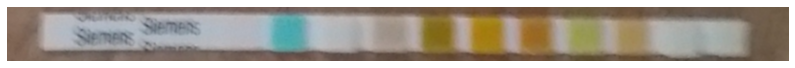

Results File:  20201125_130648.jpg


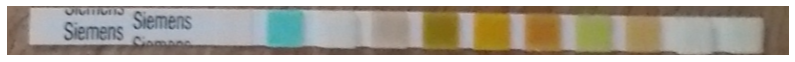

Results File:  20201125_130654.jpg


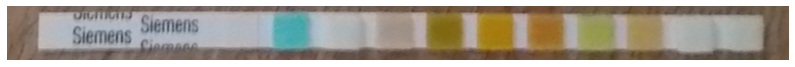

Results File:  20201125_130659.jpg


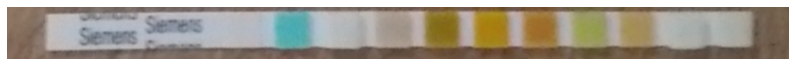

Results File:  20201125_130716.jpg


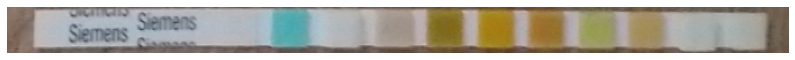

Results File:  20201125_130816.jpg


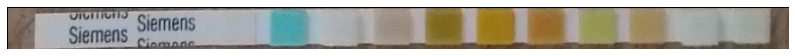

Results File:  20201125_131952.jpg


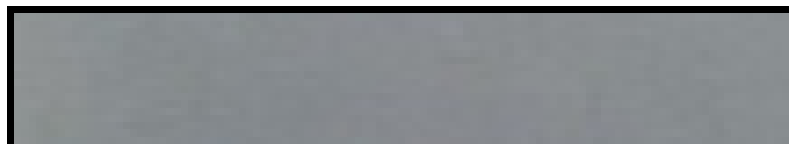

Results File:  20201125_131959.jpg


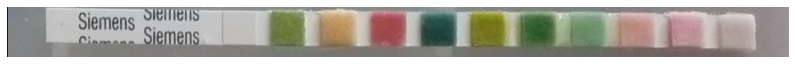

Results File:  20201125_132004.jpg


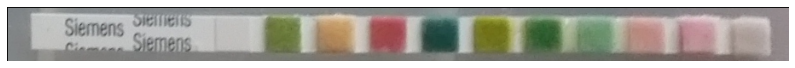

Results File:  20201125_132018.jpg


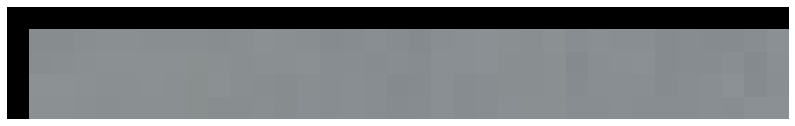

Results File:  20201125_132122.jpg


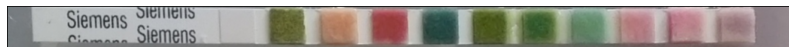

Results File:  20201125_171715.jpg


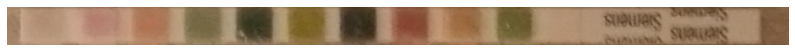

Results File:  20201125_171725.jpg


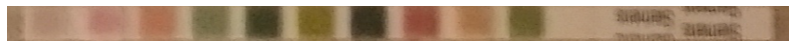

Results File:  20201125_171729.jpg


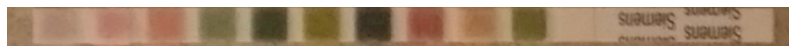

Results File:  20201125_171746.jpg


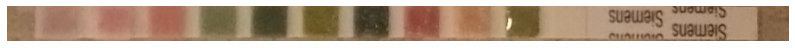

Results File:  20201125_171849.jpg


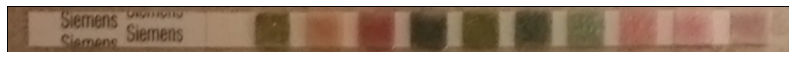

Results File:  IMG_20201214_212318.jpg


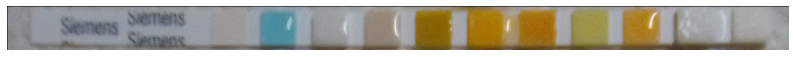

Results File:  IMG_20201214_212325.jpg


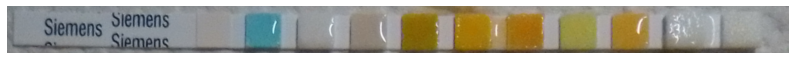

Results File:  IMG_20201214_212331.jpg


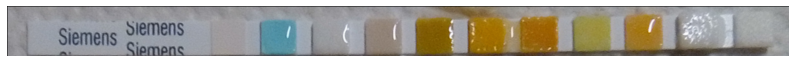

Results File:  IMG_20201214_212344.jpg


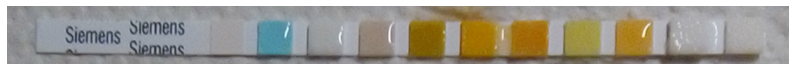

Results File:  IMG_20201214_212446.jpg


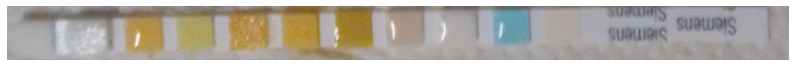

Results File:  IMG_20201214_212619_HDR.jpg


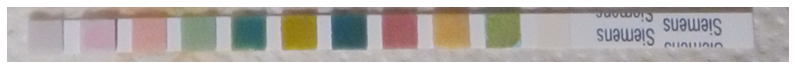

Results File:  IMG_20201214_212633_HDR.jpg


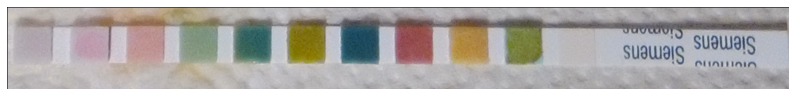

Results File:  IMG_20201214_212636_HDR.jpg


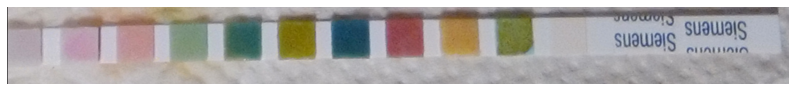

Results File:  IMG_20201214_212652_HDR.jpg


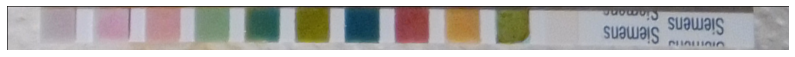

Results File:  IMG_20201214_212750_HDR.jpg


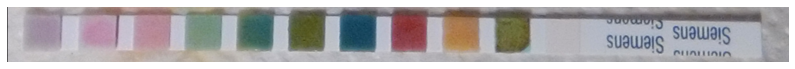

Results File:  IMG_20201214_221336_HDR.jpg


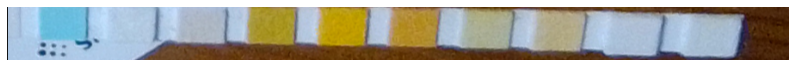

Results File:  IMG_20201214_221327_HDR.jpg


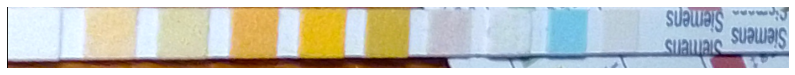

Results File:  IMG_20201214_221320_HDR.jpg


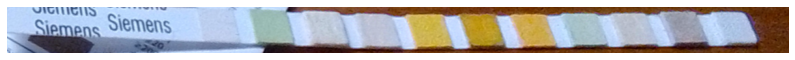

Results File:  IMG_20201214_221312_HDR.jpg


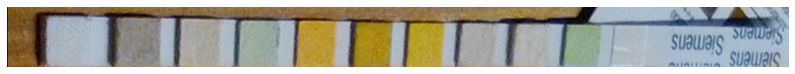

Results File:  IMG_20201214_221304_HDR.jpg


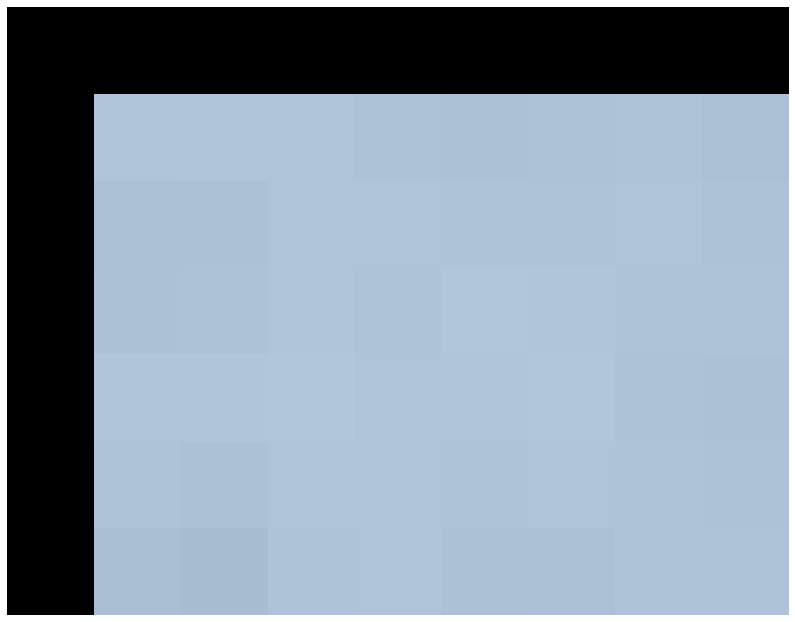

Results File:  IMG_20201214_221159_HDR.jpg


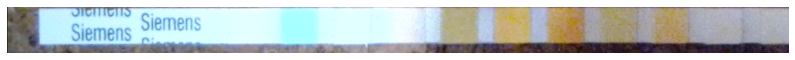

Results File:  IMG_20201214_221121_HDR.jpg


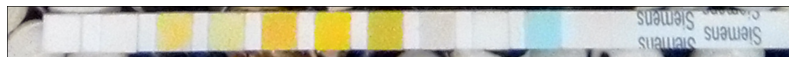

Results File:  IMG_20201214_221109_HDR.jpg


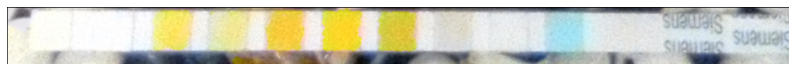

Results File:  IMG_20201214_221023_HDR.jpg


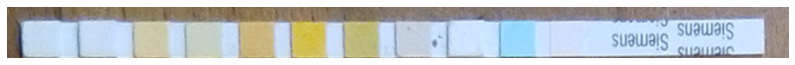

Results File:  IMG_20201214_221014_HDR.jpg


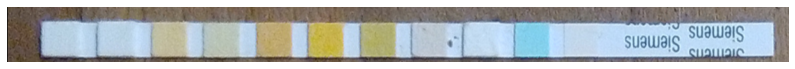

Results File:  IMG_20201214_220940_HDR.jpg


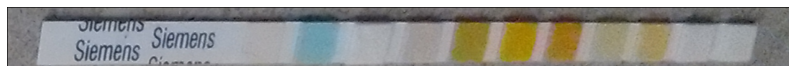

Results File:  IMG_20201214_220930_HDR.jpg


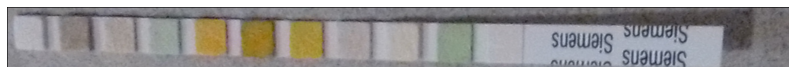

Results File:  IMG_20201214_220925_HDR.jpg


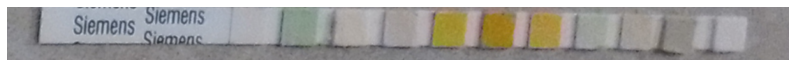

Results File:  IMG_20201214_220904_HDR.jpg


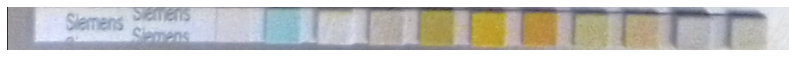

Results File:  IMG_20201214_220855_HDR.jpg


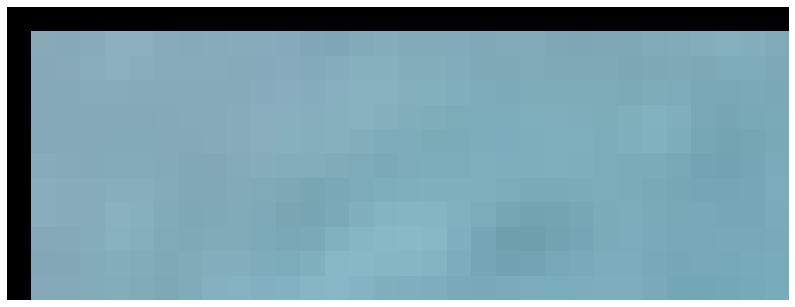

Results File:  IMG_20201214_220832_HDR.jpg


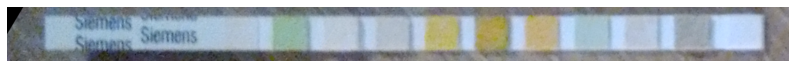

Results File:  IMG_20201214_220824_HDR.jpg


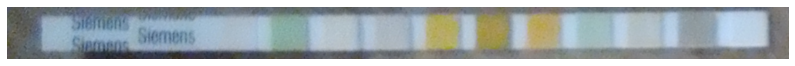

Results File:  IMG_20201214_220816_HDR.jpg


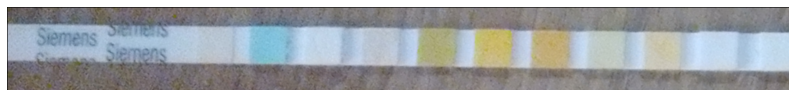

Results File:  IMG_20201214_220757_HDR.jpg


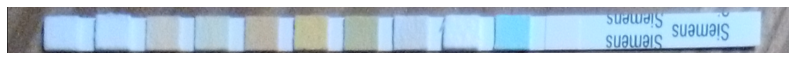

Results File:  image9.jpeg


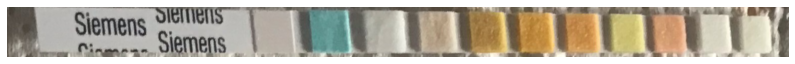

Results File:  image10.jpeg


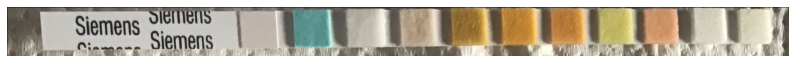

Results File:  image11.jpeg


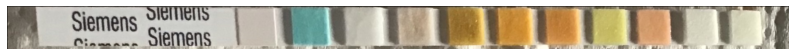

Results File:  image12.jpeg


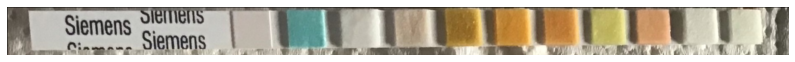

Results File:  image13.jpeg


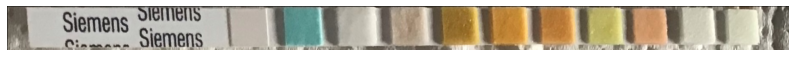

Results File:  image14.jpeg


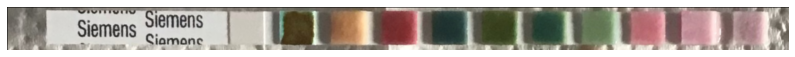

Results File:  image15.jpeg


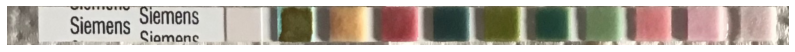

Results File:  image16.jpeg


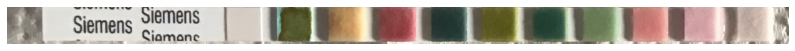

Results File:  image17.jpeg


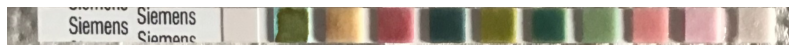

Results File:  image18.jpeg


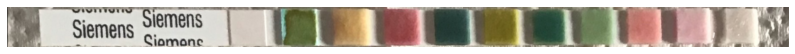

Results File:  IMG_20200803_143353_969.png


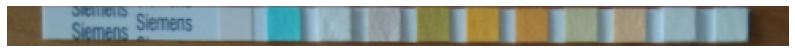

Results File:  IMG_20200803_143356_734.png


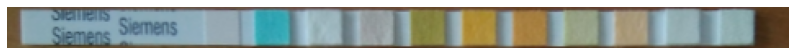

Results File:  IMG_20200803_143414_424.png


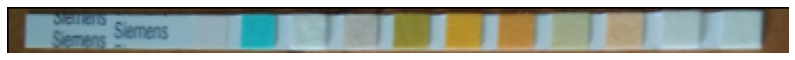

Results File:  IMG_20200803_143429_034.png


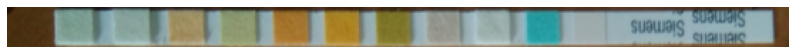

Results File:  IMG_20200803_143436_952.png


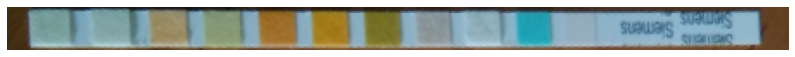

Results File:  IMG_20200803_143441_471.png


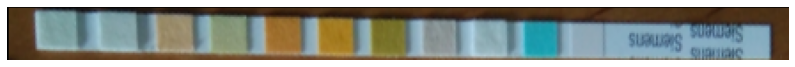

Results File:  IMG_20200803_143446_368.png


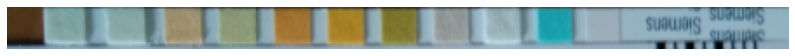

Results File:  IMG_20200803_143451_067.png


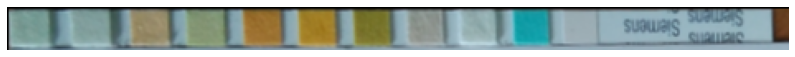

Results File:  IMG_20200803_143459_638.png


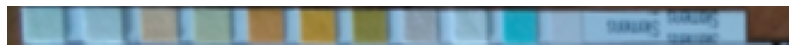

Results File:  IMG_20200803_143528_235.png


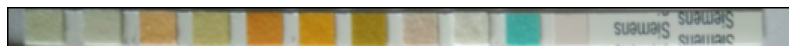

Results File:  IMG_20200803_143537_243.png


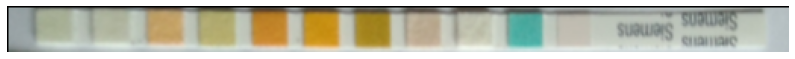

Results File:  IMG_20200803_143546_983.png


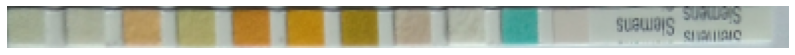

Results File:  IMG_20200803_143842_870.png


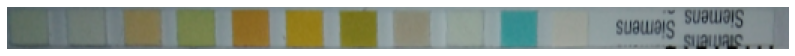

Results File:  IMG_20201202_105242_518.jpg


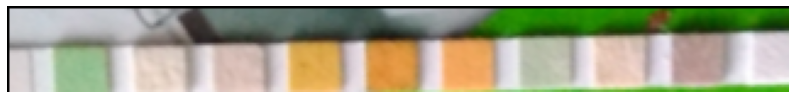

Results File:  IMG_20201202_105257_684.jpg


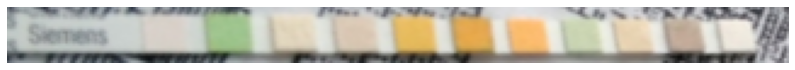

Results File:  IMG_20201202_105407_980.jpg


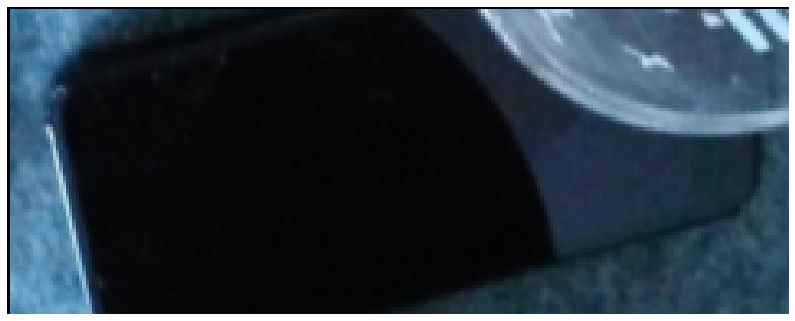

Results File:  IMG_20201202_105416_034.jpg


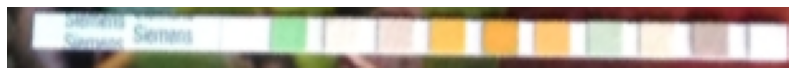

Results File:  IMG_20201202_105429_134.jpg


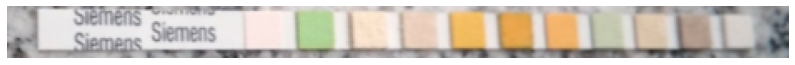

Results File:  IMG_20201202_105457_049.jpg


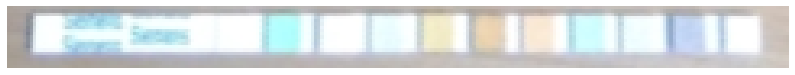

Results File:  neuerStick.png


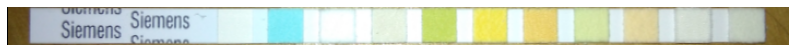

DONE


In [ ]:
import imutils
import pickle
DIR_STICKS = "/content/gdrive/MyDrive/MRCNN/dataset/found_sticks/"

f = open(ALL_RESULTS_DIR, 'rb')

while 1:
  
  try:
    result,image,annot = pickle.load(f)
  except EOFError:
    print("DONE")
    break 


  r = result[0]
  mask_sub = r['masks']
  mask_sub = mask_sub.astype(np.uint8)
  if (mask_sub.size == 0):
    print("------  ;------- ;       {}".format(annot["filename"]))
    continue
  mask_sub = mask_sub[:,:,0]
  #im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
  #ret, thresh = cv2.threshold(im, 127, 255, 0)
  cnt, hierarchy = cv2.findContours(mask_sub, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

  #cv2.drawContours(image,cnt,0,(0,0,255),2)
  #display_images([image],cols = 1)


  img_h, img_w, _ = image.shape
  T = np.float32([[1, 0, img_w/2], [0, 1, img_h/2]])
  img_mod = cv2.warpAffine(image, T, (img_w*2, img_h*2))

  if not cnt:
    continue
    print("------  ;------- ;       {}".format(annot["filename"]))
    
  rectangle = cv2.minAreaRect(cnt[0])
  
  #check if ratio of rectangle is okay
  len_faktor_h = 1.1;
  len_faktor_w = 1.1;
  try:
    w_h_ratio = max(rectangle[1][0] / rectangle[1][1],rectangle[1][1] / rectangle[1][0])
  except:
    print("------  ;------- ;       {}".format(annot["filename"]))
    continue

  # if w_h_ratio<118/5:
  #   if rectangle[1][0] > rectangle[1][1]:
  #     len_faktor_w = 118/5/w_h_ratio;
  #   else:
  #     len_faktor_h = 118/5/w_h_ratio;


  rectangle = ((rectangle[0][0]+img_w/2, rectangle[0][1]+img_h/2), (rectangle[1][0]*len_faktor_w, rectangle[1][1]*len_faktor_h),(rectangle[2]))

  stick_corners = cv2.boxPoints(rectangle)

  detected_stick = crop_rect(img_mod, rectangle)
  # Correction of the Orientation of the Stick

  im_size = detected_stick.shape
  angle_is = 0
  if im_size[1] < im_size[0]:
    detected_stick = imutils.rotate_bound(detected_stick, -90)
    angle_is = 90

  delta = stick_corners[2] - stick_corners[1]
  angle_target = math.atan2(delta[1], delta[0])/math.pi*180

  angle_is = angle_is + rectangle[2]

  if abs(angle_is-angle_target) > 70:
      detected_stick = imutils.rotate_bound(detected_stick, 180)
  image_path = DIR_STICKS + annot["filename"]
  skimage.io.imsave(image_path, detected_stick)
  print("Results File: ", annot["filename"])
  display_images([detected_stick],cols = 1)
  box = cv2.boxPoints(rectangle)

In [16]:
image_dir = "/content/gdrive/My Drive/Kontrollurin/"
DIR_STICKS = "/content/gdrive/My Drive/Kontrollurin/found_sticks/"
all_imgs = os.listdir(image_dir)
results =[]
for img in all_imgs:
  # For single images
  image = skimage.io.imread(image_dir + img)

  # Run object detection
  result = model.detect([image], verbose=0)
  r = result[0]
  mask_sub = r['masks']
  mask_sub = mask_sub.astype(np.uint8)
  if (mask_sub.size == 0):
    print("------  ;------- ;       {}".format(img))
    continue
  mask_sub = mask_sub[:,:,0]
  #im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
  #ret, thresh = cv2.threshold(im, 127, 255, 0)
  cnt, hierarchy = cv2.findContours(mask_sub, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

  #cv2.drawContours(image,cnt,0,(0,0,255),2)
  #display_images([image],cols = 1)


  img_h, img_w, _ = image.shape
  T = np.float32([[1, 0, img_w/2], [0, 1, img_h/2]])
  img_mod = cv2.warpAffine(image, T, (img_w*2, img_h*2))

  #check if ratio of rectangle is okay
  len_faktor_h = 1.1;
  len_faktor_w = 1.1;
  rectangle = cv2.minAreaRect(cnt[0])
  try:
    w_h_ratio = max(rectangle[1][0] / rectangle[1][1],rectangle[1][1] / rectangle[1][0])
  except:
    print("------  ;------- ;       {}".format(annot["filename"]))
    continue

  rectangle = ((rectangle[0][0]+img_w/2, rectangle[0][1]+img_h/2), (rectangle[1][0]*len_faktor_w, rectangle[1][1]*len_faktor_h),(rectangle[2]))

  stick_corners = cv2.boxPoints(rectangle)

  detected_stick = crop_rect(img_mod, rectangle)
  # Correction of the Orientation of the Stick

  im_size = detected_stick.shape
  angle_is = 0
  if im_size[1] < im_size[0]:
    detected_stick = imutils.rotate_bound(detected_stick, -90)
    angle_is = 90

  delta = stick_corners[2] - stick_corners[1]
  angle_target = math.atan2(delta[1], delta[0])/math.pi*180

  angle_is = angle_is + rectangle[2]

  if abs(angle_is-angle_target) > 70:
      detected_stick = imutils.rotate_bound(detected_stick, 180)
  image_path = DIR_STICKS + img
  skimage.io.imsave(image_path, detected_stick)
  print("Results File: ", img)
  display_images([detected_stick],cols = 1)

Output hidden; open in https://colab.research.google.com to view.